<h4>Name: Khor Yu Yang<br>Admin: 2123590<br>Class: DAAA/FT/2B/01

In [1]:
import numpy as np
import datetime
import torch.nn as nn
import torch
import matplotlib.pyplot as plt
import tensorflow as tf
from tqdm import tqdm
from math import ceil
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from sklearn.metrics import roc_auc_score, f1_score


In [15]:
#Loading Cifar10 data into training and testing set
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.cifar10.load_data()


In [16]:
print(f'X_train Shape: {X_train.shape}')
print(f'y_train Shape: {y_train.shape}')
print(f'X_test Shape: {X_test.shape}')
print(f'y_test Shape: {y_test.shape}')

X_train Shape: (50000, 32, 32, 3)
y_train Shape: (50000, 1)
X_test Shape: (10000, 32, 32, 3)
y_test Shape: (10000, 1)


<h3>Exploratory Data Analysis

In [17]:
label_names = ['airplane', 'automobile', 'bird', 'cat', 'deer',
               'dog', 'frog', 'horse', 'ship', 'truck']

labels = y_train

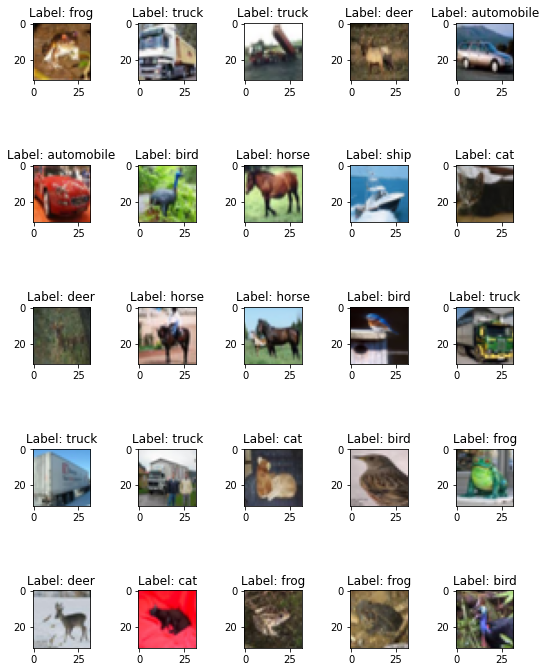

In [18]:
#  import matplotlib's pyplot library to visualize MNIST images

# define number of images to show
num_row = 5
num_col = 5
num= num_row*num_col
# get images
images_cut = X_train[0:num]
labels_cut = y_train[0:num]

# plot images
fig, axes = plt.subplots(num_row, num_col, figsize=(1.5*num_col,2*num_row))
for i in range(num):
     ax = axes[i//num_col, i%num_col]
     ax.imshow(images_cut[i], cmap='gray_r')
     ax.set_title('Label: {}'.format(label_names[labels_cut[i][0]]))
plt.tight_layout()
# plt.close()
plt.show()

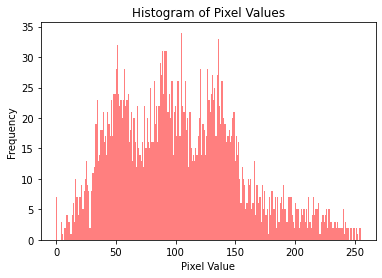

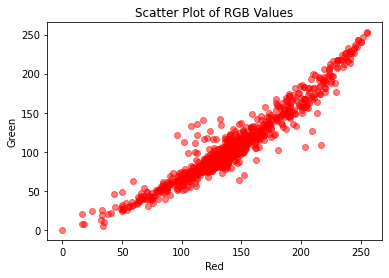

In [19]:
import matplotlib.pyplot as plt

# Histogram of the pixel values of the first image
plt.hist(X_train[0].ravel(), bins=256, color='red', alpha=0.5)
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.title('Histogram of Pixel Values')
plt.show()

# Scatter plot of the RGB values of the first image
r = X_train[0, :, :, 0].ravel()
g = X_train[0, :, :, 1].ravel()
b = X_train[0, :, :, 2].ravel()

plt.scatter(r, g, color='red', alpha=0.5)
plt.xlabel('Red')
plt.ylabel('Green')
plt.title('Scatter Plot of RGB Values')
plt.show()


<h5>Histogram<h5>shows the pixel values of the first image in the CIFAR-10 dataset.the distribution of the color channels in the image is almost normally distributed, slightly skewed to the right<br><h5>Scatter plot<h5> plot the RGB values of the first image in the CIFAR-10 dataset. Relationship between the color channels in the image are strong and positive. They have high correlation

In [20]:
# Find the unique numbers from the train labels (Coarse)
classes = np.unique(y_train)
nClasses = len(classes)
print('Total number of outputs : ', nClasses)
print('Output classes : ', classes)

Total number of outputs :  10
Output classes :  [0 1 2 3 4 5 6 7 8 9]


<h1>DCGAN

<h3>Baseline Architecture

<h4>Generator

In [21]:
# Baseline Generator Architecture 
class baseline_Generator(nn.Module):
    def __init__(self, g_filter=64, channels_img=3, z_dim=100):
        super(baseline_Generator, self).__init__()
        self.gen = nn.Sequential(
            self._block(z_dim, g_filter*8, 4, 1, 0),
            self._block(g_filter*8, g_filter*4, 4, 2, 1),
            self._block(g_filter*4, g_filter*2, 4, 2, 1),
            self._block(g_filter*2, g_filter, 4, 2, 1),
            nn.ConvTranspose2d(g_filter, channels_img, 3, 1, 1),
            nn.Tanh(), # [-1,1]
            # PrintLayer()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.LeakyReLU(0.01),
            # PrintLayer()
            
        )

    def forward(self, x):
        return self.gen(x)


def build_baseline_generator():
    gen = baseline_Generator()
    return gen

build_baseline_generator()

baseline_Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.01)
    )
    (4): ConvTranspose2d(64, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): Tanh()
  )
)

<h4>Discriminator

In [22]:
# Baseline Discriminator Architecture
class baseline_Discriminator(nn.Module):
    def __init__(self, d_filter=64):
        super(baseline_Discriminator, self).__init__()
        #input layer of size 32,32,3
        self.dis = nn.Sequential(
            nn.Conv2d(
                3, d_filter, kernel_size=3, stride=1, padding=1
            ),
            nn.LeakyReLU(0.1),
            self._block(d_filter, d_filter*2, 3, 2, 1), #16x16
            self._block(d_filter*2, d_filter*4, 3, 2, 1), #8x8
            self._block(d_filter*4, d_filter*8, 3, 2, 1), #4x4
            nn.Conv2d(d_filter*8, 1, 3, 2, 0, bias=False), # 1x1
            nn.Sigmoid(),
            # PrintLayer()
        )
        
    
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias = False,
            ),
            nn.LeakyReLU(0.1),
            # PrintLayer()
        )


    def forward(self, x):
        return self.dis(x)

def build_baseline_discriminator():
    dis = baseline_Discriminator()
    return dis

build_baseline_discriminator()

baseline_Discriminator(
  (dis): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.1)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.1)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.1)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.1)
    )
    (5): Conv2d(512, 1, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (6): Sigmoid()
  )
)

<h3>Improved/Modified Model from baseline

<h4>Building Generator/Discriminator

In [23]:
class PrintLayer(nn.Module):
    def __init__(self):
        super(PrintLayer, self).__init__()

    def forward(self, x):
        print(x.shape)
        return x

In [2]:
#Modified Generator
class Generator(nn.Module):
    def __init__(self, g_filter=64, channels_img=3, z_dim=100):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            self._block(z_dim, g_filter*8, 4, 1, 0),
            self._block(g_filter*8, g_filter*4, 4, 2, 1),
            self._block(g_filter*4, g_filter*2, 4, 2, 1),
            self._block(g_filter*2, g_filter, 4, 2, 1),
            nn.ConvTranspose2d(g_filter, channels_img, 3, 1, 1),
            nn.Tanh(), # [-1,1]
            # PrintLayer()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(0.01),
            # PrintLayer()
            
        )

    def forward(self, x):
        return self.gen(x)


def build_generator():
    gen = Generator()
    return gen

build_generator()

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=Tr

Added batchnormalization layer to generator. It can stabilize the training process by reducing the internal covariate shift, as well as speeding up training process by normalizing activations <br>Activation function is also chosen to be ReLU and tanh after several experiments with different activation functions 

In [25]:
# Modified Discriminator
class Discriminator(nn.Module):
    def __init__(self, d_filter=64):
        super(Discriminator, self).__init__()
        #input layer of size 32,32,3
        self.dis = nn.Sequential(
            nn.Conv2d(
                3, d_filter, kernel_size=3, stride=1, padding=1
            ),
            # nn.BatchNorm2d(d_filter),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.25),
            self._block(d_filter, d_filter*2, 3, 2, 1), #16x16
            self._block(d_filter*2, d_filter*4, 3, 2, 1), #8x8
            self._block(d_filter*4, d_filter*8, 3, 2, 1), #4x4
            nn.Conv2d(d_filter*8, 1, 3, 2, 0, bias=False), # 1x1
            nn.Sigmoid(),
            # PrintLayer()
        )
        
    
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias = False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.25),
            # PrintLayer()
        )


    def forward(self, x):
        return self.dis(x)

def build_discriminator():
    dis = Discriminator()
    return dis

build_discriminator()

Discriminator(
  (dis): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.25, inplace=False)
    (3): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
      (3): Dropout(p=0.25, inplace=False)
    )
    (4): Sequential(
      (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
      (3): Dropout(p=0.25, inplace=False)
    )
    (5): Sequential(
      (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(n

Added batchnormalization layer to discriminator, that could help to stabilize the training process and improve the discriminator's ability to distinguish real from generated samples<br>Dropout layer is also added to discriminator to improve the stability of the training process and reduce overfitting to the generator's generated samples

<h3>Initialize weight

In [26]:
#initialize weight to both generator/discriminator layers
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m ,(nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


In [27]:
import torch as ts

# def evaluation(images):
#     #calculate inception score
#     #!higher is_mean indicate higher quality of image

#Evaluate discriminator performance AUC/ROC curve
def dis_evaluate(fake_images,real_images,dis):

    # Generate predictions for the real and generated images
    real_preds = dis(real_images).reshape(-1)
    fake_preds = dis(fake_images).reshape(-1)

    # Create labels for the real and generated images
    real_labels = np.ones(real_preds.shape)
    fake_labels = np.zeros(fake_preds.shape)

    # Concatenate the real and generated predictions and labels
    preds = np.concatenate((real_preds.cpu(), fake_preds.cpu()))
    labels = np.concatenate((real_labels, fake_labels))

    # Calculate the AUC-ROC score
    auc = roc_auc_score(labels, preds)
    print("AUC-ROC score:", auc)

    # Calculate the F1 score
    f1 = f1_score(labels, np.round(preds))
    print("F1 score:", f1)


def plot_images(images, e):
    # scale from [-1,1] to [0,1]
    # grid_size = ceil(np.sqrt(images.shape[0]))
    # images = (images.reshape(grid_size, grid_size, h, w, c)
    #           .transpose(0, 2, 1, 3, 4)
    #           .reshape(grid_size*h, grid_size*w, c))
    # plot images
    # for i in range(n):
    # # define subplot
    #     plt.subplot(n, n, 1 + i)
    #     # turn off axis
    #     plt.axis('off')
    #     # plot raw pixel data
    #     plt.figure(figsize=(16, 16))
    #     plt.imshow(images[i, :, :])
    #     plt.imsave(f'fake_images_e{n}.png', images[i, :, :])
    #     plt.show()
    mean = [0.5, 0.5, 0.5]
    std = [0.5, 0.5, 0.5]
    n = 5
    images = images.clone().detach().cpu().numpy()
    mean = np.array(mean).reshape(1,3,1,1)
    std = np.array(std).reshape(1,3,1,1)
    images = images * std + mean
    images = images * 255
    images = images.clip(0, 255).astype(np.uint8)
    # images = images.transpose((0, 2, 3, 1))
    # images = images/255
    for i in range(n):
        plt.subplot(2, 5, i+1, xticks=[], yticks=[])
        # plt.imshow(((images[i] + 1)* 127).astype(np.uint8))
        # plt.imshow(((np.transpose(images[i], (1,2,0)) + 1)* 127))
        plt.imshow(np.transpose(images[i], (1,2,0)))

    plt.savefig(f"fake_images_ep{e}.png")
    plt.tight_layout()
    plt.show()

#Function to plot loss graphs for both dis and gen
def plot_losses(losses_d, losses_g, filename):
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    axes[0].plot(losses_d)
    axes[1].plot(losses_g)
    axes[0].set_title("losses_d")
    axes[1].set_title("losses_g")
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

Generate TensorBoard

In [28]:
from torch.utils import tensorboard
%load_ext tensorboard
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 3784), started 1:23:12 ago. (Use '!kill 3784' to kill it.)

<IPython.core.display.Javascript object>

Files already downloaded and verified
Epoch = 1/40, batch = 390/128, dis_loss=0.695, gen_loss=1.157 
loss_d=0.69489, loss_g=1.15747


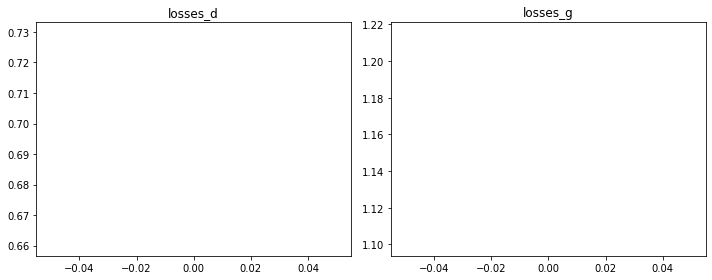

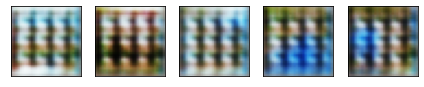

AUC-ROC score: 0.56484375
F1 score: 0.5648854961832062
Epoch = 6/40, batch = 390/128, dis_loss=0.605, gen_loss=1.351 
loss_d=0.60540, loss_g=1.35052


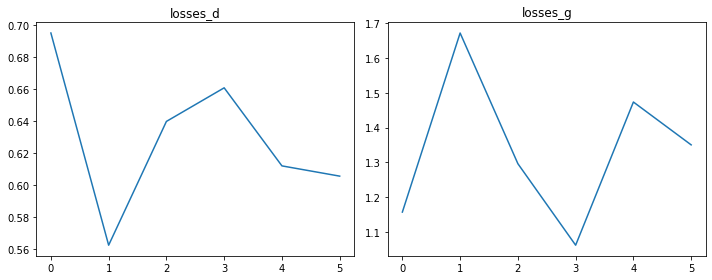

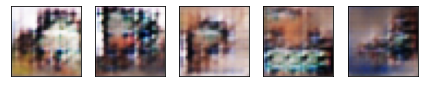

AUC-ROC score: 0.7199218749999999
F1 score: 0.7417218543046357
Epoch = 11/40, batch = 390/128, dis_loss=0.569, gen_loss=1.204 
loss_d=0.56891, loss_g=1.20424


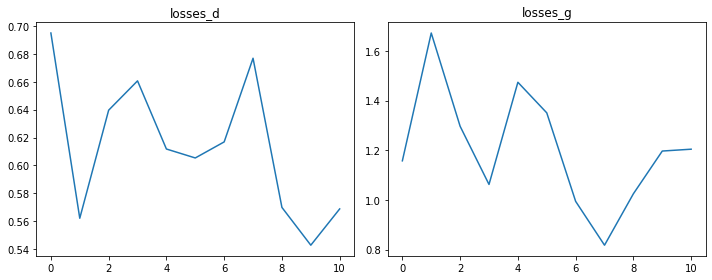

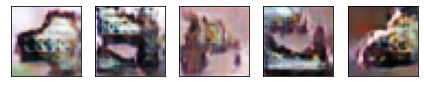

AUC-ROC score: 0.736328125
F1 score: 0.8048780487804876
Epoch = 16/40, batch = 390/128, dis_loss=0.590, gen_loss=1.083 
loss_d=0.59020, loss_g=1.08309


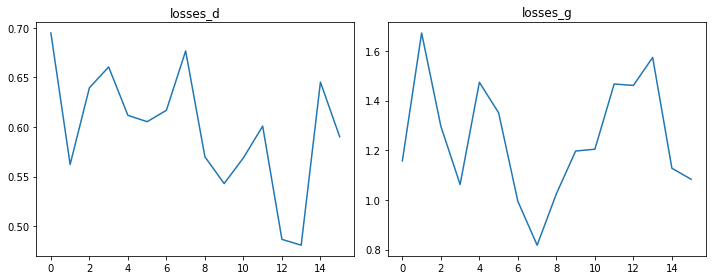

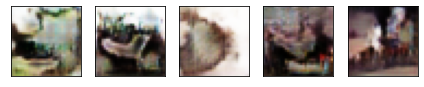

AUC-ROC score: 0.8570312499999999
F1 score: 0.8427672955974843
Epoch = 21/40, batch = 390/128, dis_loss=0.540, gen_loss=1.238 
loss_d=0.53989, loss_g=1.23848


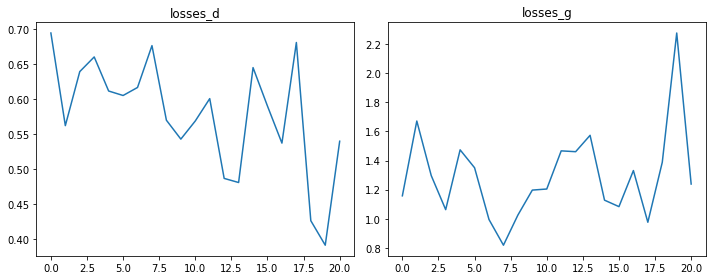

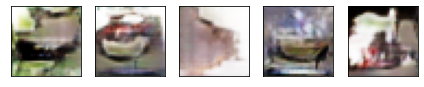

AUC-ROC score: 0.9105468750000001
F1 score: 0.8666666666666666
Epoch = 26/40, batch = 390/128, dis_loss=0.346, gen_loss=1.683 
loss_d=0.34623, loss_g=1.68322


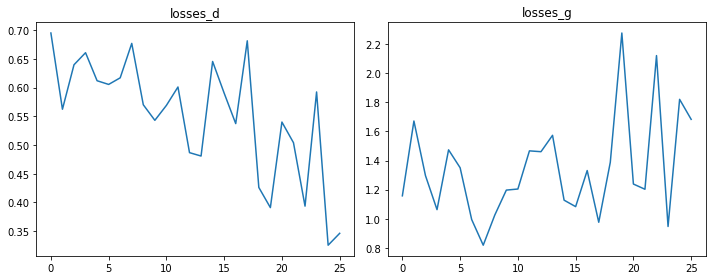

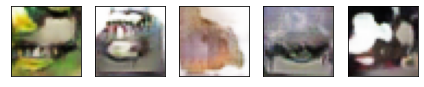

AUC-ROC score: 0.994140625
F1 score: 0.9411764705882354
Epoch = 31/40, batch = 390/128, dis_loss=0.453, gen_loss=1.962 
loss_d=0.45295, loss_g=1.96234


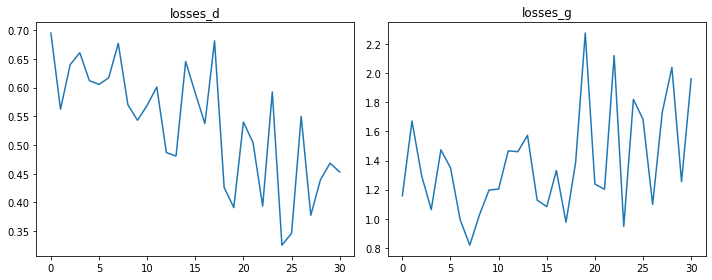

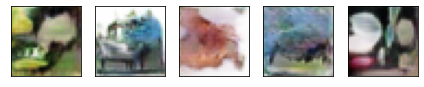

AUC-ROC score: 0.9781249999999999
F1 score: 0.9139072847682119
Epoch = 36/40, batch = 390/128, dis_loss=0.422, gen_loss=2.091 
loss_d=0.42193, loss_g=2.09095


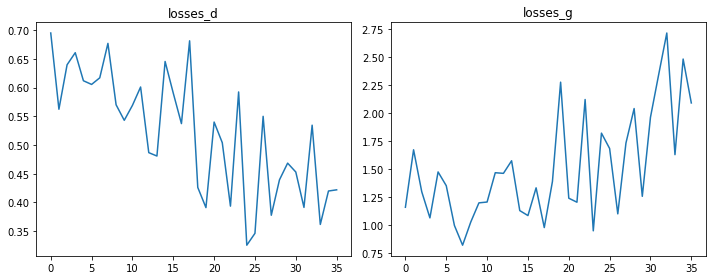

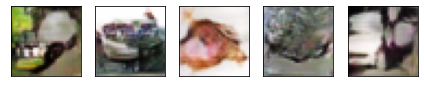

AUC-ROC score: 0.9222656250000001
F1 score: 0.881578947368421


In [29]:
#Hyperparameters tuning
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') #make sure it is using gpu
lr = 2e-4 #lr for both gen and dis
batch_size = 128
image_size = 32
channel_img = 3
z_dim = 100
epochs = 40
# feat_d = 32
# feat_g = 32
epoch_per_checkpoint = 5
batchid_per_checkpoint = 100

#Data Preprocessing PipeLine
transforms = transforms.Compose(
    [
        # resize input image to 32,32,3
        transforms.Resize(image_size),
        transforms.ToTensor(), # convert to PyTorch Tensor
        # Normalize the input tensor
        transforms.Normalize(
            [0.5 for _ in range(channel_img)], [0.5 for _ in range(channel_img)] #normalize data
            ),
    ]
)

#Load cifar10 dataset
data = datasets.CIFAR10(root='dataset/', train=True, transform=transforms, download=True)
loader = DataLoader(data, batch_size=batch_size, shuffle=True)

#Load Generator and Discriminator
gen = build_generator().to(device)
dis = build_discriminator().to(device)

#initialize GEN and DIS weights
initialize_weights(gen)
initialize_weights(dis)

#Optimizers
opt_gen = optim.Adam(gen.parameters(), lr = lr, betas=(0.5, 0.999))
opt_dis = optim.Adam(dis.parameters(), lr = lr, betas=(0.5, 0.999))

#Loss function
criterion = nn.BCELoss()
#Generate noise
fixed_noise = torch.randn(32, z_dim, 1, 1).to(device)

#Tensorboard writer
writer_real = SummaryWriter(f"logs/real")
writer_fake = SummaryWriter(f"logs/fake")
step = 0

gen.train()
dis.train()

losses_d, losses_g = [], []

#Training LOOP
for e in range(epochs):
    for batch_id, (real, _) in enumerate(loader):
        real = real.to(device)
        #Generate Noise
        noise = torch.randn((batch_size, z_dim, 1, 1)).to(device)
        fake = gen(noise) # Generating fake images
        
        #!Train Discriminator
        # On Real images
        dis_real = dis(real).reshape(-1)
        loss_dis_real = criterion(dis_real, torch.ones_like(dis_real)) #label 1

        # On Fake images
        dis_fake = dis(fake).reshape(-1)
        loss_dis_fake = criterion(dis_fake, torch.zeros_like(dis_fake)) #label 0

        # Calculate Average Loss for discriminator
        total_loss_dis = (loss_dis_real + loss_dis_fake) /2
        dis.zero_grad()
        total_loss_dis.backward(retain_graph=True)
        opt_dis.step()

        #!Train Generator
        output = dis(fake).reshape(-1)
        #calculate loss for generator
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        # Log images and data to tensorboard every 100 batch
        if (batch_id % batchid_per_checkpoint) == 0:
            with torch.no_grad():
                fake = gen(fixed_noise)

                #take out 32 examples
                real_img_grid = torchvision.utils.make_grid(
                    real[:32], normalize=True
                )
                fake_img_grid = torchvision.utils.make_grid(
                    fake[:32], normalize=True
                )

                #Log images/ Losses of generator/ discriminator
                writer_real.add_image('Real', real_img_grid, global_step=step)
                writer_fake.add_image('Fake', fake_img_grid, global_step=step)
                writer_fake.add_scalar('Dis', total_loss_dis, global_step=step)
                writer_fake.add_scalar('Gen', loss_gen, global_step=step)
            step += 1
    
    losses_d.append(total_loss_dis.cpu())
    losses_g.append(loss_gen.cpu())

    # Calculate result and generated images to show every 5 epochs
    if (e % epoch_per_checkpoint) == 0:
        print('Epoch = %d/%d, batch = %d/%d, dis_loss=%.3f, gen_loss=%.3f' % (e +1, epochs, batch_id, batch_size , total_loss_dis, loss_gen), 50*'')
        print("loss_d={:.5f}, loss_g={:.5f}".format(total_loss_dis, loss_gen))

        with torch.no_grad():
            # Plot loss graph
            plot_losses(losses_d, losses_g, "losses.png")
            fake = gen(fixed_noise)
            # Plot generated images to show
            plot_images(fake,e)
            # show f1 score for discriminator
            dis_evaluate(fake, real, dis)

        torch.save(gen.state_dict(), f"generator_{e}.pt")
        torch.save(dis.state_dict(), f"discriminator_{e}.pt")


<h1>Evaluation

<h4>Inception Score. It measures the quality and diversity of generated images by evaluating the exponential of the KL divergence between the predicted class probabilities and the true class probabilities

<h3>Final Loss Graph for Discriminator/Generator

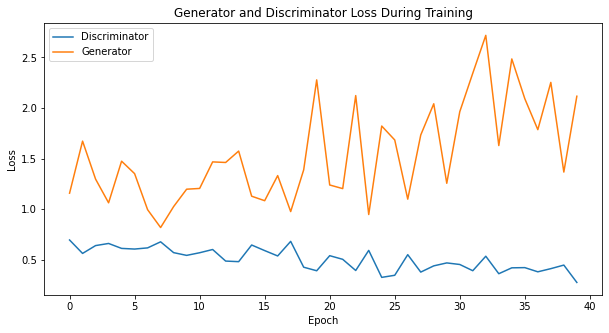

In [30]:
with torch.no_grad():
  plt.figure(figsize=(10,5))
  plt.title("Generator and Discriminator Loss During Training")
  plt.plot(losses_d,label="Discriminator")
  plt.plot(losses_g,label="Generator")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend()
  plt.show()

we can observe from the result that the loss for generator is the lowest at around epoch 25, and the discriminator loss is lowest at epoch 40

In [9]:
import torch.nn.functional as F
from torch.autograd import Variable
from scipy.stats import entropy

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') #make sure it is using gpu

# Function to calculate inception score
def INceptionScore(imgs, cuda=False, batch_size=128, resize=False, splits=1):
    """
    Computes the Inception Score of a set of generated images.
    imgs -- a PyTorch tensor of shape (N, C, H, W), where N is the number of images,
            C is the number of channels, H is the height, and W is the width.
    cuda -- a flag indicating whether to run on GPU
    abatch_size -- the batch size for feeding into Inception v3
    resize -- a flag indicating whether to resize the images
    splits -- the number of splits for computing the mean and standard deviation.
    """
    transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size=(299, 299)),
    # torchvision.transforms.ToTensor(),
    # torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406],
    #                                  std=[0.229, 0.224, 0.225])
    ])

    imgs = [transform(img) for img in imgs]
    imgs = torch.stack(imgs)

    N = imgs.shape[0]

    # assert batch_size > 0
    # assert N > batch_size

    # Set up dtype
    if cuda:
        dtype = torch.cuda.FloatTensor
    else:
        if torch.cuda.is_available():
            print("WARNING: You have a CUDA device, so you should probably set cuda=True")
        dtype = torch.FloatTensor

    # Set up dataloader
    dataloader = torch.utils.data.DataLoader(imgs, batch_size=batch_size)

    # Load inception model
    inception_model = torchvision.models.inception_v3(pretrained=True, transform_input=False).type(dtype)
    inception_model.eval()
    up = nn.Upsample(size=(299, 299), mode='bilinear').type(dtype)
    def get_pred(x):
        if resize:
            x = up(x)
        x = inception_model(x)
        return F.softmax(x).data.numpy()

    # Get predictions
    preds = np.zeros((N, 1000))

    for i, batch in enumerate(dataloader, 0):
        batch = batch.type(dtype)
        batchv = Variable(batch)
        batch_size_i = batch.size()[0]

        preds[i*batch_size:i*batch_size + batch_size_i] = get_pred(batchv)

    # Now compute the mean kl-div
    split_scores = []

    for k in range(splits):
        part = preds[k * (N // splits): (k+1) * (N // splits), :]
        py = np.mean(part, axis=0)
        scores = []
        for i in range(part.shape[0]):
            pyx = part[i, :]
            scores.append(entropy(pyx, py))
        split_scores.append(np.exp(np.mean(scores)))

    #!higher is_mean indicate higher quality of image
    return np.mean(split_scores), np.std(split_scores)


We will also generate 1000  cifar10 images using the generator that we have just trained at epoch 25

In [5]:
def generate_random():
  #Load the generator
  load_gen = build_generator().to('cpu')

  # Load state dict into model
  # load_gen.load_state_dict(torch.load('./gan_images/generator.pt', map_location=torch.device('cpu')))
  load_gen.load_state_dict(torch.load('./dcgan_model/generator_25.pt', map_location=torch.device('cpu')))
  # Sets the model to evaluation mode, disable dropout.batchnormal needed for training
  load_gen.eval()

  # generate noise for prediction 
  noise = torch.randn((100, 100, 1, 1)).to('cpu')
  # generate fake images
  fake = load_gen(noise)

  return fake

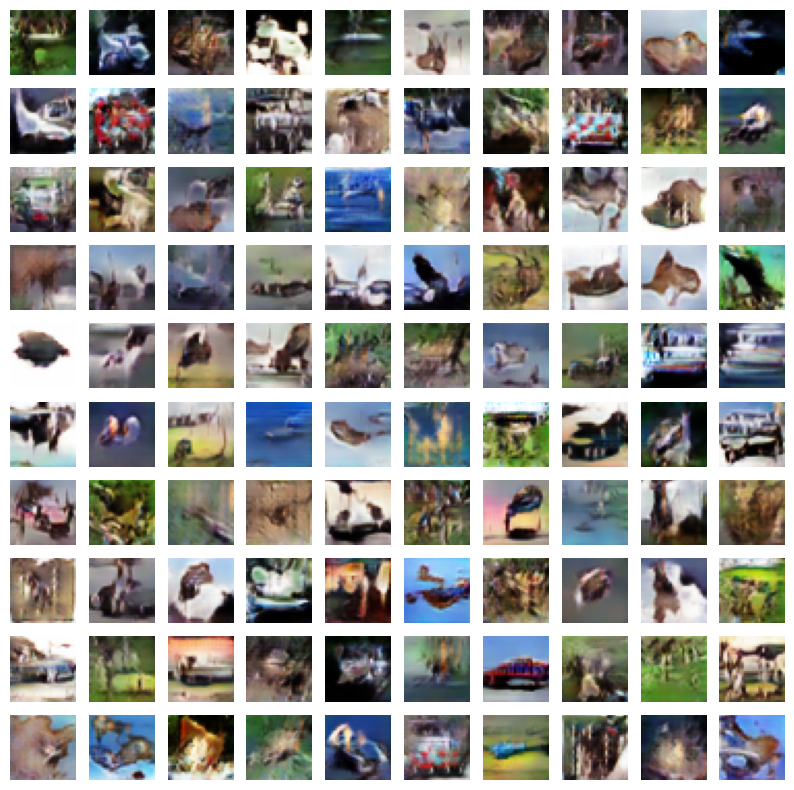

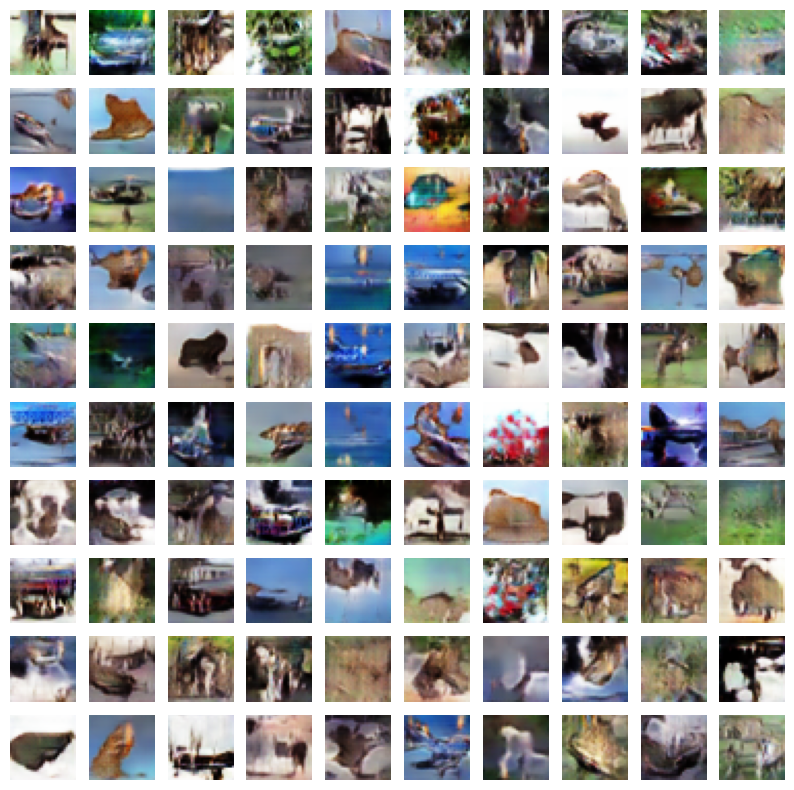

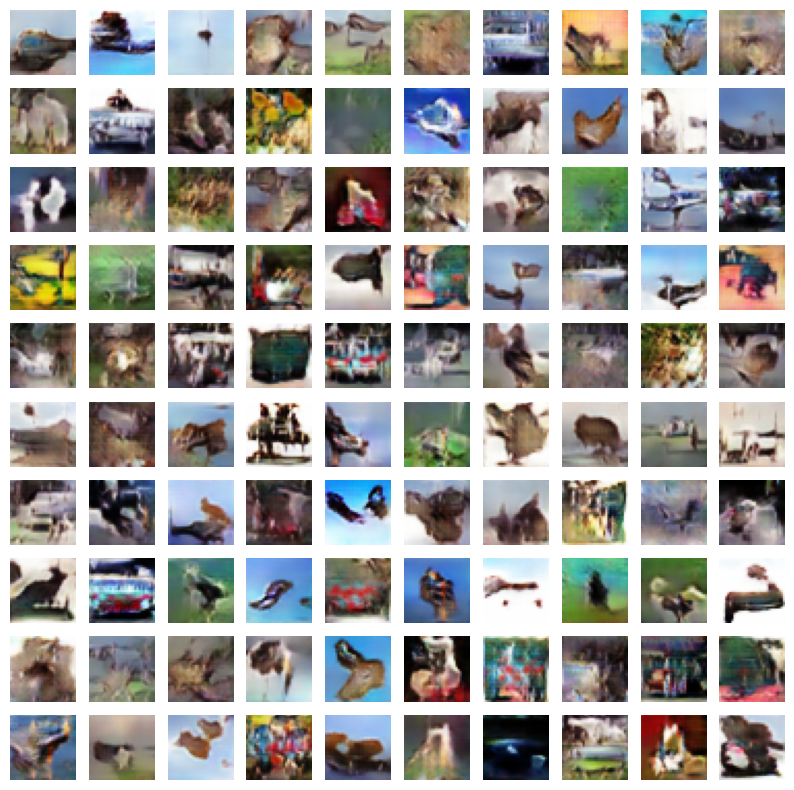

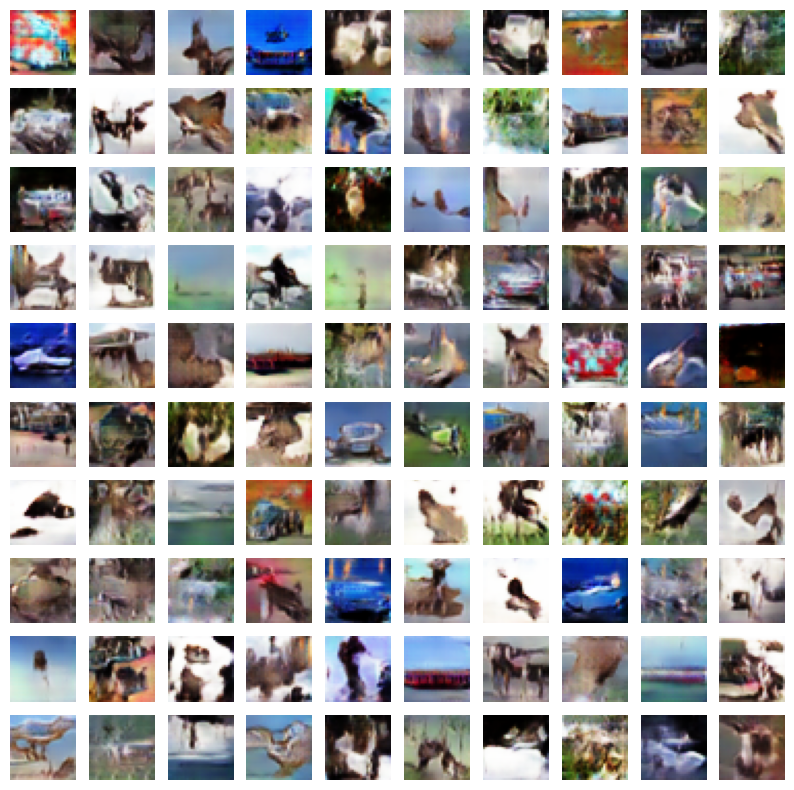

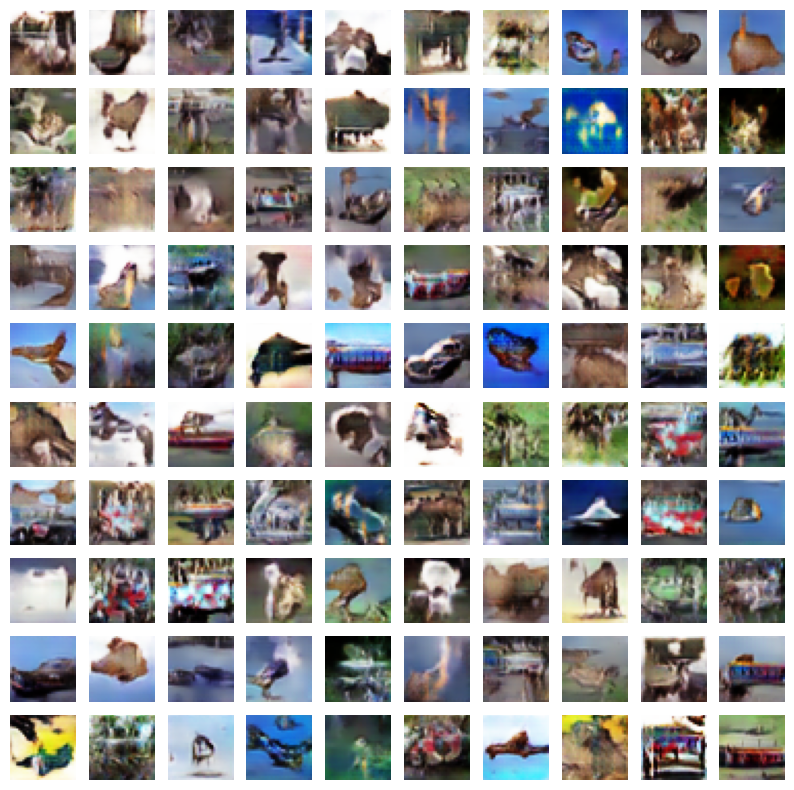

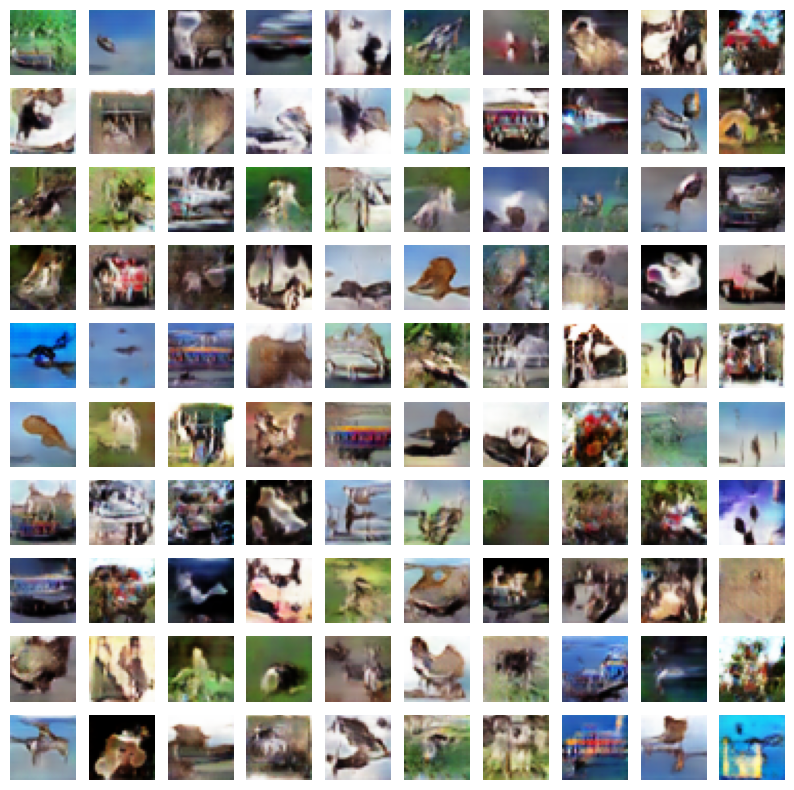

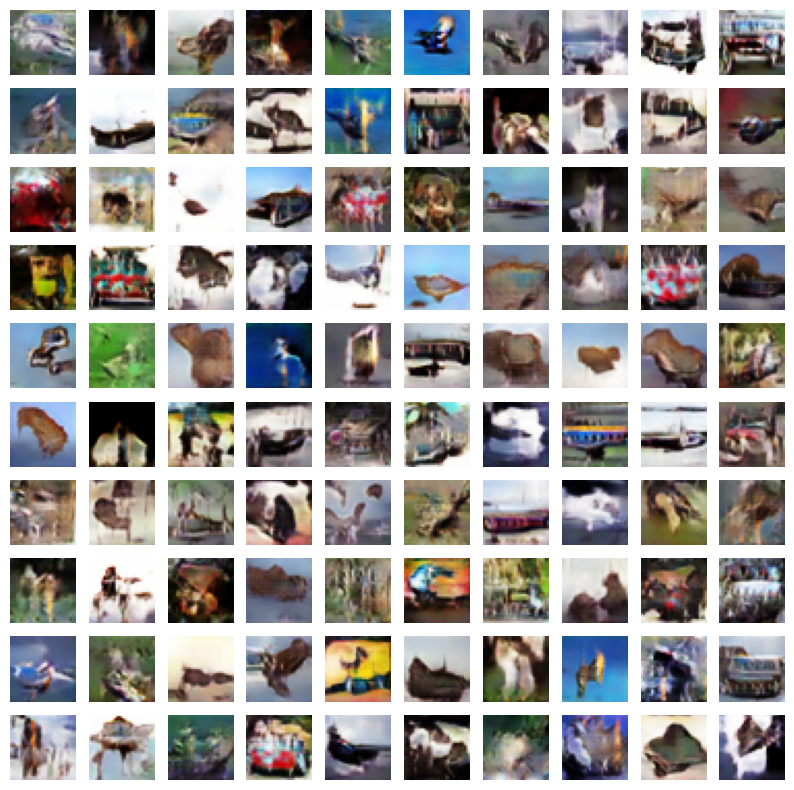

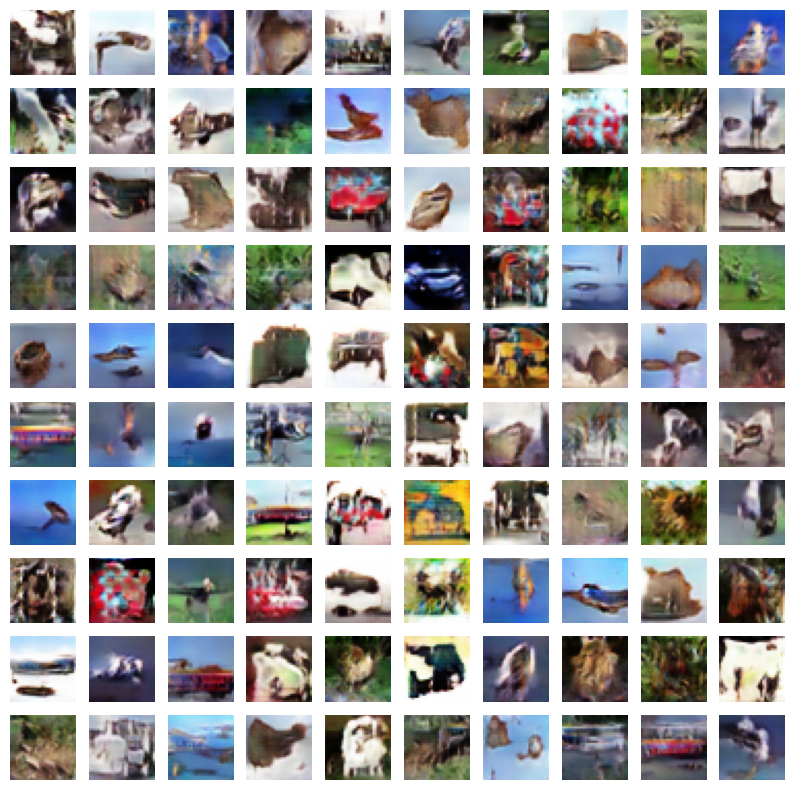

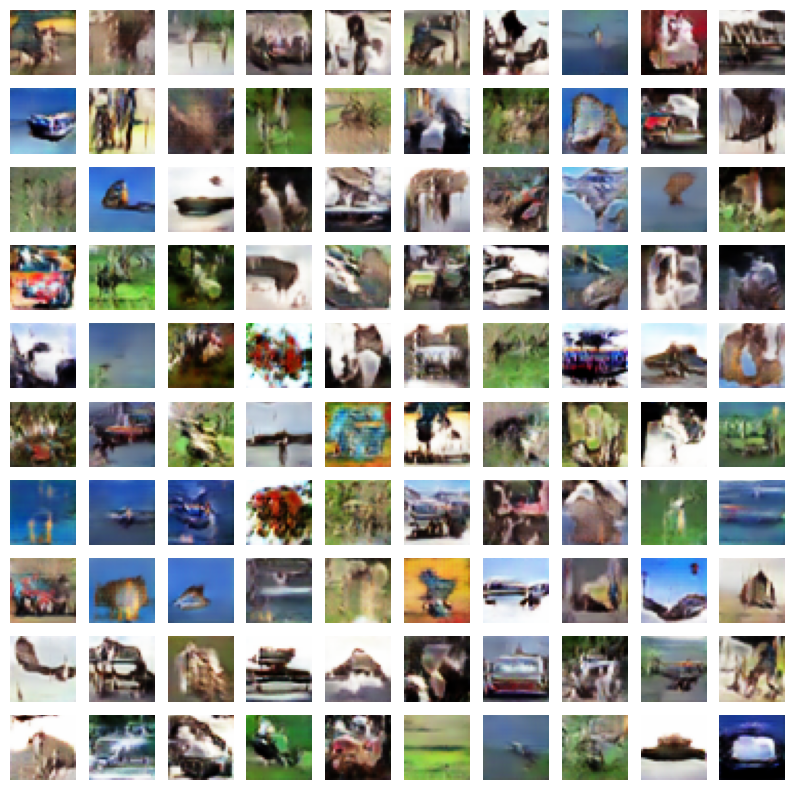

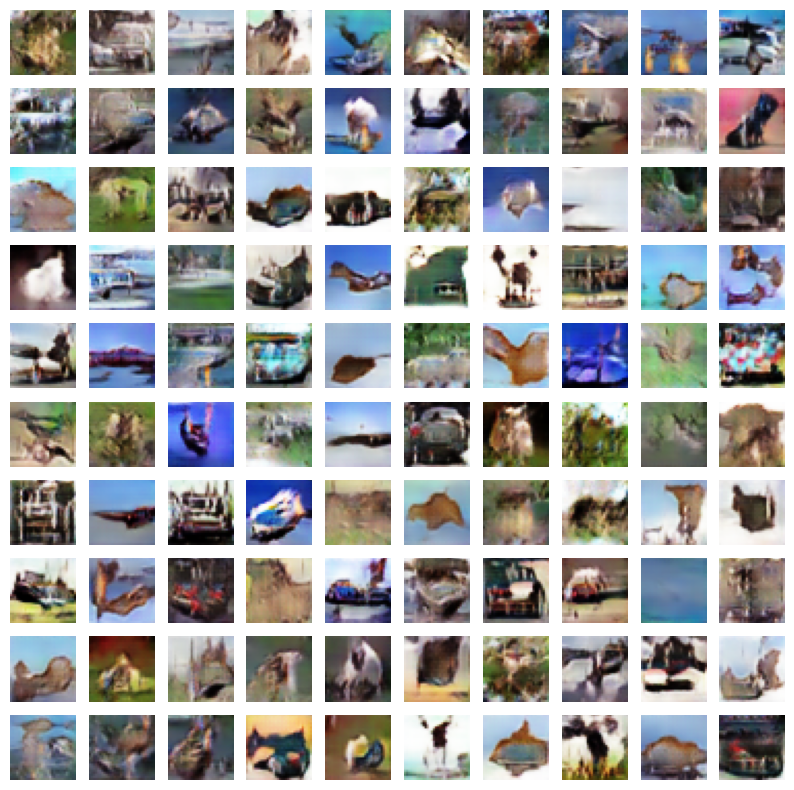

In [11]:
# Generate 1000 images
for total in range(10): 
  #Retrieve generated Images
  gen_img = generate_random()

  mean = [0.5, 0.5, 0.5]
  std = [0.5, 0.5, 0.5]
  gen_img = gen_img.clone().detach().cpu().numpy()
  mean = np.array(mean).reshape(1,3,1,1)
  std = np.array(std).reshape(1,3,1,1)
  gen_img = gen_img * std + mean
  gen_img = gen_img * 255
  gen_img = gen_img.clip(0, 255).astype(np.uint8)
  # Plot a 10x10 grid of the generated images
  fig, axes = plt.subplots(10, 10, figsize=(10, 10))
  for i in range(10):
      for j in range(10):
          axes[i, j].imshow(np.transpose(gen_img[10 * i + j], (1,2,0)), cmap='gray')
          axes[i, j].axis('off')

  # save images generated by generator 
  plt.savefig(f"./gan_images/generated_images_{total+1}.png")
  plt.show()


<h3>Frechet Inception Distance

In [13]:
from torchmetrics.image.fid import FrechetInceptionDistance
import torch.nn.functional as F

# Initialize the FID function
fid = FrechetInceptionDistance(feature=64)

# Call preprocess pipline for images
transformer = transforms.Compose(
    [
        transforms.Resize(size=(299, 299)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(3)], [0.5 for _ in range(3)] #normalize data
            ),
    ]
)

#Load cifar10 dataset
data = datasets.CIFAR10(root='dataset/', train=True, transform=transformer, download=True)
loader = DataLoader(data, batch_size=128, shuffle=True)

# Loop to get both the fake & real images
for batch ,(real,_) in enumerate(loader):
    real=real.to('cpu')
    noise=torch.randn(128,100,1,1).to('cpu') #fake real
    gen_img = generate_random()
    break

gen_img = (gen_img + 1) / 2 * 255
gen_img = gen_img.to(torch.float32)
gen_img = F.interpolate(gen_img, size=299, mode='bilinear', align_corners=False)
gen_img = (gen_img / 255 * 2 - 1).to(torch.uint8)
real = (real + 1) / 2 * 255
real = real.to(torch.uint8)
fid.update(gen_img.detach().cpu(),real=False)
fid.update(real.detach().cpu(),real=True)

# Compute the FID score, lower the better
print(f"FID score: {fid.compute()}")

Files already downloaded and verified
FID score: 31.21829605102539


In [6]:
#Retrieve generated Images
gen_img = generate_random()

# Compute the Inception Score
mean, std = INceptionScore(gen_img)

print("Inception Score:", mean)
print("Standard Deviation:", std)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception Score: 4.24677288961271
Standard Deviation: 0.0


<ipython-input-4-c300b5f5ad3b>:52: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(x).data.numpy()


<h3>References:<br><h5>https://www.youtube.com/watch?v=IZtv9s_Wx9I&t=1662s<br>https://github.com/sbarratt/inception-score-pytorch/blob/master/inception_score.py<br>https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html<br>https://www.kaggle.com/code/shwetagoyal4/dcgan-using-pytorch/notebook